In [2]:
import pandas as pd
import numpy as np
import datetime as dt
from matplotlib import pyplot as plt
import seaborn as sns
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
import cufflinks as cf

In [3]:
%matplotlib inline

In [4]:
init_notebook_mode(connected=True)

In [5]:
cf.go_offline()

In [6]:
df = pd.read_csv('conhecimento.csv')

In [7]:
df[:1000].iplot(kind='scatter', x='ndvi', y='nbrl')

In [5]:
sns.set_style('whitegrid')

In [5]:
df = pd.read_csv('conhecimento.csv')

## Separa em 2 sub-conjuntos(queimadas e nao_queimadas)

In [7]:
df['verifica'] = df.verifica.apply(lambda x: 'queimada' if x == 1 else 'nao_queimada')
df1 = df[df.verifica=='queimada'] # queimada
df3 = df[df.verifica=='nao_queimada'] # nao queimada

In [8]:
print('QUEIMADA')
df1.describe()

QUEIMADA


,ndvi,nbrl,dif_ndvi,dif_dnbrl,medianb2,medianb3,medianb4,medianb5,medianb6,medianb7,id
count,113184.000000,113184.000000,113184.000000,113184.000000,113184.000000,113184.000000,113184.000000,113184.000000,113184.000000,113184.000000,1.131840e+05
mean,0.226356,0.011152,0.173211,0.248001,0.109385,0.099383,0.117826,0.188681,0.621125,0.185466,4.416280e+06
std,0.059957,0.079079,0.094378,0.119682,0.017468,0.022776,0.032972,0.048024,3.434797,0.056094,2.280954e+06
min,-0.507201,-0.753977,-0.065708,0.000000,0.066379,0.045448,0.032622,0.016253,0.005842,0.008838,2.101400e+04
25%,0.185310,-0.039758,0.106120,0.160890,0.098669,0.084960,0.096125,0.158214,0.192681,0.148901,2.373944e+06
50%,0.224413,0.009293,0.155019,0.221400,0.106015,0.096094,0.114774,0.188654,0.233781,0.183199,4.384632e+06
75%,0.266749,0.061435,0.215183,0.296315,0.116183,0.109124,0.135411,0.217144,0.274958,0.218364,6.991396e+06
max,0.542561,0.431150,0.787095,1.205911,0.784851,0.743309,0.792964,0.921527,38.582066,1.536971,7.564726e+06


In [9]:
print('NAO_QUEIMADA')
des_3 = df3.describe()
des_3

NAO_QUEIMADA


,ndvi,nbrl,dif_ndvi,dif_dnbrl,medianb2,medianb3,medianb4,medianb5,medianb6,medianb7,id
count,275367.000000,275367.000000,275367.000000,275367.000000,275367.000000,275367.000000,275367.000000,275367.000000,275367.000000,275367.000000,2.753670e+05
mean,0.314787,0.174871,0.233534,0.290336,0.145918,0.143685,0.156234,0.294951,0.424857,0.209078,3.601712e+06
std,0.086081,0.095718,0.096030,0.110302,0.041950,0.045670,0.050521,0.065975,1.540715,0.058452,1.940034e+06
min,-0.621544,-0.749672,-0.126101,-0.005284,0.068000,0.044790,0.030617,0.014229,-3.488903,0.004941,1.752800e+04
25%,0.254206,0.110873,0.157720,0.204120,0.110990,0.107108,0.118811,0.249108,0.256897,0.168728,2.196236e+06
50%,0.310063,0.170081,0.223624,0.280369,0.138607,0.138634,0.150966,0.290510,0.296199,0.201991,3.455528e+06
75%,0.376879,0.237938,0.299479,0.359452,0.173645,0.172470,0.184431,0.338610,0.346243,0.243720,4.731056e+06
max,0.639127,0.582693,0.756723,0.922058,0.768113,0.748524,0.777741,0.844699,32.051437,1.188263,7.569192e+06


## Cria uma amostra de nao_queimada
Amostra criada, devido a grande número da população de nao_queimada

In [10]:
ids_3 = np.random.choice(df3.id, len(df1), replace=False)
df3_amostra = df[df.id.isin(ids_3)].copy().reset_index(drop=True)

## Descreve os dados da amosta para verificar se a mesma representa a população

Mostrando estatistica descritiva dos atributos e gráficos para visualizar a semelhança entre os 2 conjuntos

In [11]:
print('AMOSTRA')
des_3_amostra = df3_amostra.describe()
des_3_amostra

AMOSTRA


,ndvi,nbrl,dif_ndvi,dif_dnbrl,medianb2,medianb3,medianb4,medianb5,medianb6,medianb7,id
count,113184.000000,113184.000000,113184.000000,113184.000000,113184.000000,113184.000000,113184.000000,113184.000000,113184.000000,113184.000000,1.131840e+05
mean,0.314922,0.175084,0.233106,0.289808,0.145741,0.143507,0.156077,0.294685,0.426025,0.208855,3.595585e+06
std,0.086229,0.096163,0.096026,0.110137,0.041786,0.045530,0.050498,0.065908,1.542430,0.058565,1.932005e+06
min,-0.473504,-0.285474,-0.126101,-0.005284,0.072093,0.044818,0.030672,0.015253,0.006671,0.005370,1.752800e+04
25%,0.254314,0.110982,0.157490,0.203641,0.110919,0.106996,0.118587,0.248786,0.256395,0.168342,2.196200e+06
50%,0.310261,0.170365,0.223006,0.279938,0.138318,0.138263,0.150761,0.290221,0.296114,0.201734,3.455358e+06
75%,0.377131,0.238062,0.298597,0.358809,0.173435,0.172352,0.184294,0.338351,0.346118,0.243464,4.730714e+06
max,0.639127,0.582693,0.685309,0.833781,0.750167,0.731246,0.760874,0.833020,32.051437,0.624952,7.569192e+06


In [12]:
## Histograma de ndvi do 

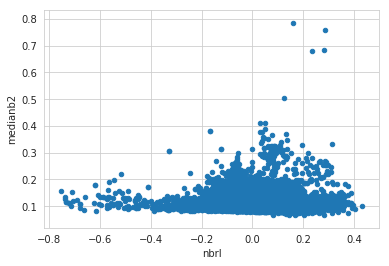

In [13]:
df1.plot(kind='scatter', x='nbrl', y='medianb2')

In [14]:
df1.iplot(kind='scatter', x='nbrl', y='medianb2', mode='markers')

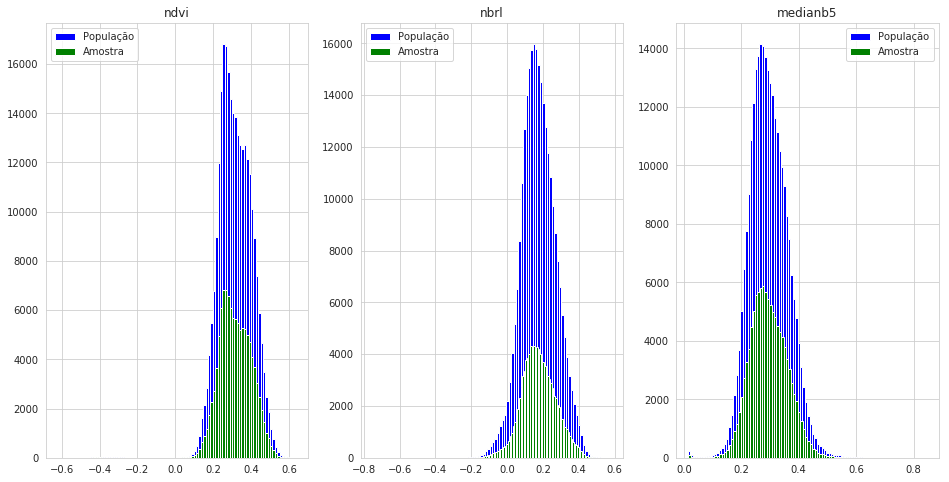

In [12]:
fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(16,8))
# hist
plt.subplot(1, 3, 1)
plt.title('ndvi')
df3.ndvi.hist(bins=100, facecolor='b', label='População')
df3_amostra.ndvi.hist(bins=100, facecolor='g', label='Amostra')
plt.legend()

plt.subplot(1, 3, 2)
plt.title('nbrl')
df3.nbrl.hist(bins=100, facecolor='b', label='População')
df3_amostra.nbrl.hist(bins=100, facecolor='g', label='Amostra')
plt.legend()

plt.subplot(1, 3, 3)
plt.title('medianb5')
df3.medianb5.hist(bins=100, facecolor='b', label='População')
df3_amostra.medianb5.hist(bins=100, facecolor='g', label='Amostra')
plt.legend()

## Diferença entre os dados descritivos dos 2 conjuntos
Na tabela abaixo, mostra que a diferença entre os 2 conjuntos é muito pequena, muito próximo do zero. 
Indicando que podemos usar uma amostra aleatória ao invés da população de nao_queimada

In [21]:
des_3 - des_3_amostra

,ndvi,nbrl,dif_ndvi,dif_dnbrl,medianb2,medianb3,medianb4,medianb5,medianb6,medianb7,id
count,162183.000000,162183.000000,162183.000000,162183.000000,162183.000000,162183.000000,162183.000000,162183.000000,162183.000000,162183.000000,162183.000000
mean,0.000110,0.000095,0.000082,-0.000129,-0.000022,-0.000027,-0.000032,0.000013,0.001773,-0.000003,3411.233738
std,-0.000090,-0.000091,-0.000191,-0.000026,-0.000145,-0.000124,-0.000086,-0.000063,0.011674,0.000059,2634.386664
min,-0.139903,-0.373077,-0.133530,0.000000,-0.002513,0.000000,0.000000,-0.001993,-3.496377,-0.000706,-142.000000
25%,0.000100,0.000088,0.000421,-0.000095,0.000052,-0.000010,-0.000052,-0.000122,-0.000173,-0.000175,266.250000
50%,0.000132,-0.000062,0.000488,0.000026,0.000071,0.000063,-0.000040,0.000185,-0.000044,-0.000071,4.000000
75%,0.000082,-0.000112,-0.000142,-0.000287,-0.000073,-0.000107,0.000117,0.000384,0.000445,0.000336,8.250000
max,0.000000,0.024855,0.000000,0.059436,0.008806,0.002490,0.002696,0.011142,0.000000,0.563311,0.000000


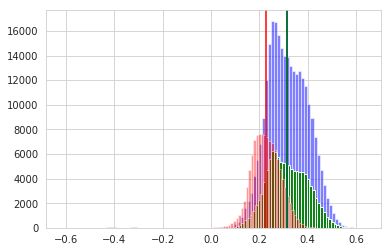

In [16]:
df3.ndvi.hist(bins=100, facecolor='b', alpha=0.5)
df3_amostra.ndvi.hist(bins=100, facecolor='g', alpha=0.9)
ax = df1.ndvi.hist(bins=100, facecolor='r', alpha=0.4)
ax.axvline(df1.ndvi.mean(), c='r')
ax.axvline(df3.ndvi.mean(), c='b')
ax.axvline(df3_amostra.ndvi.mean(), c='g')

In [8]:
id_cenas = sorted(df[df.id_cena.str.contains('221067201')].id_cena.unique())

/home/queimadas/.conda/envs/py3/lib/python3.6/site-packages/matplotlib/pyplot.py:522: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


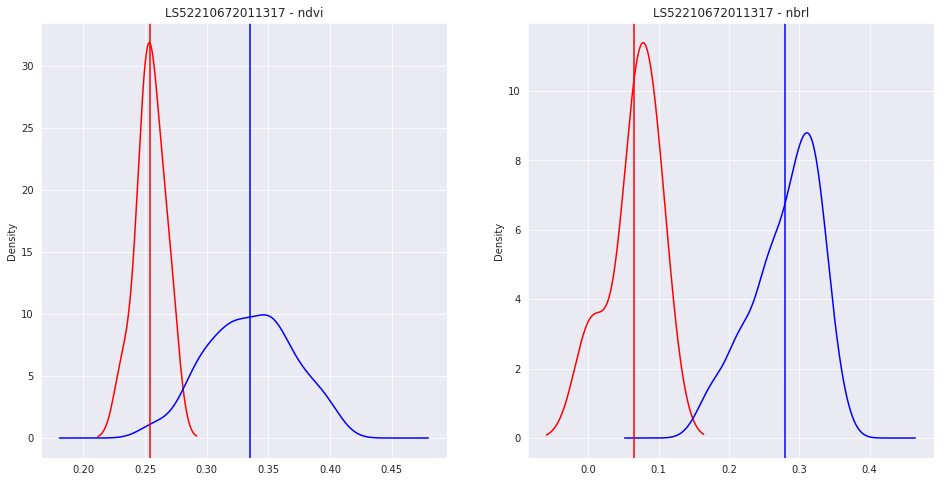

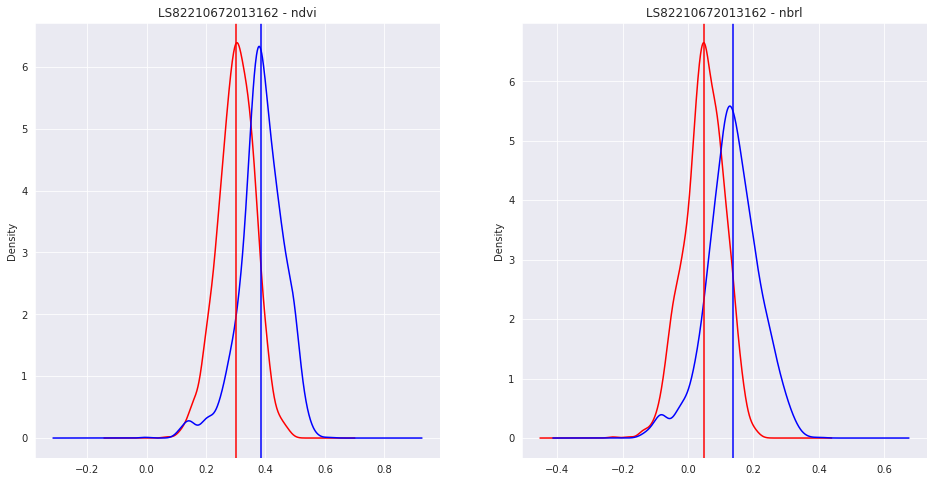

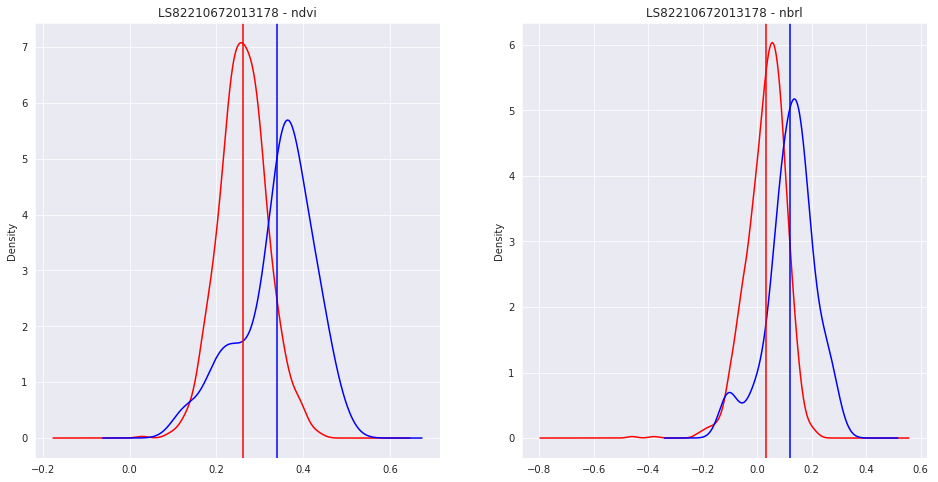

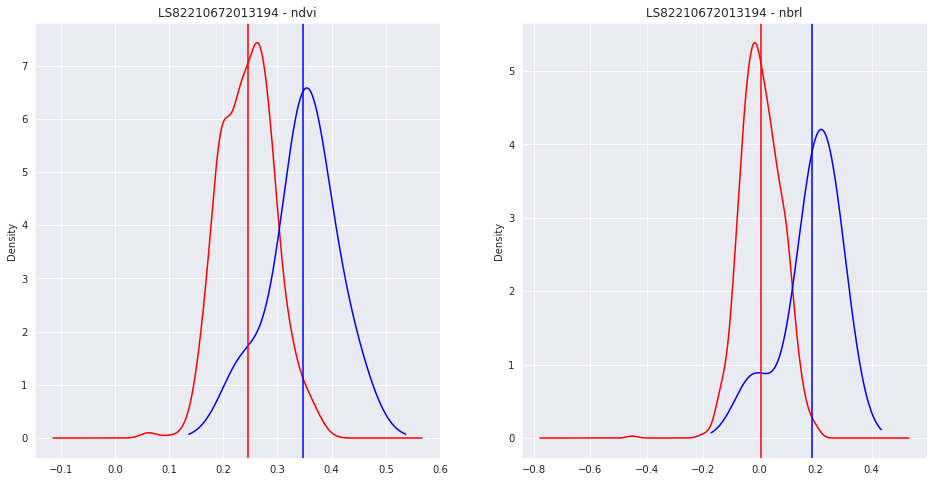

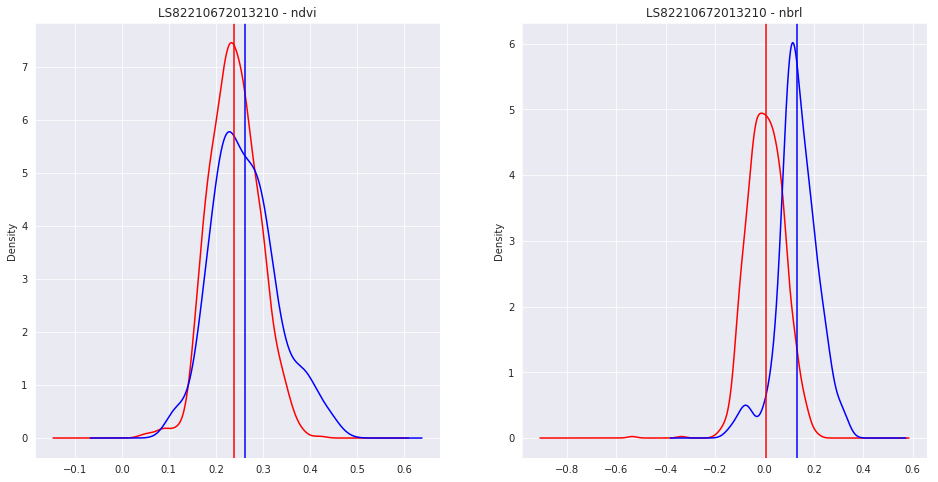

...

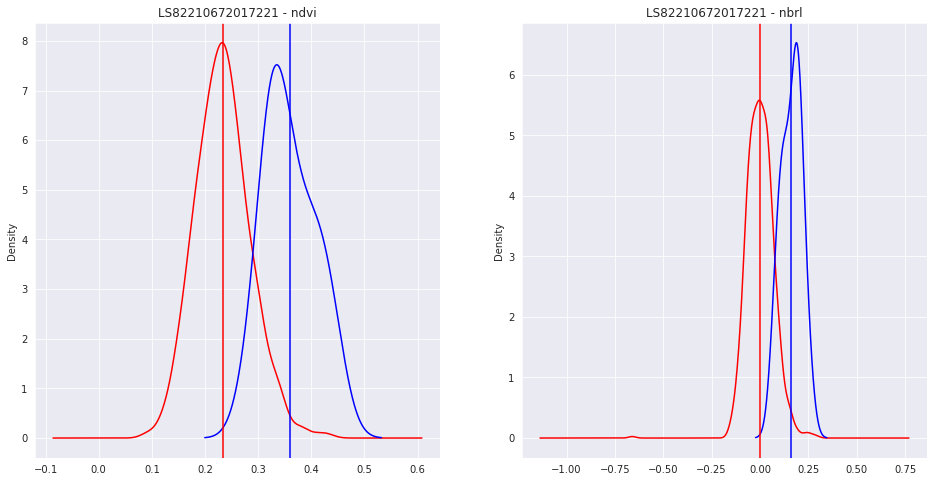

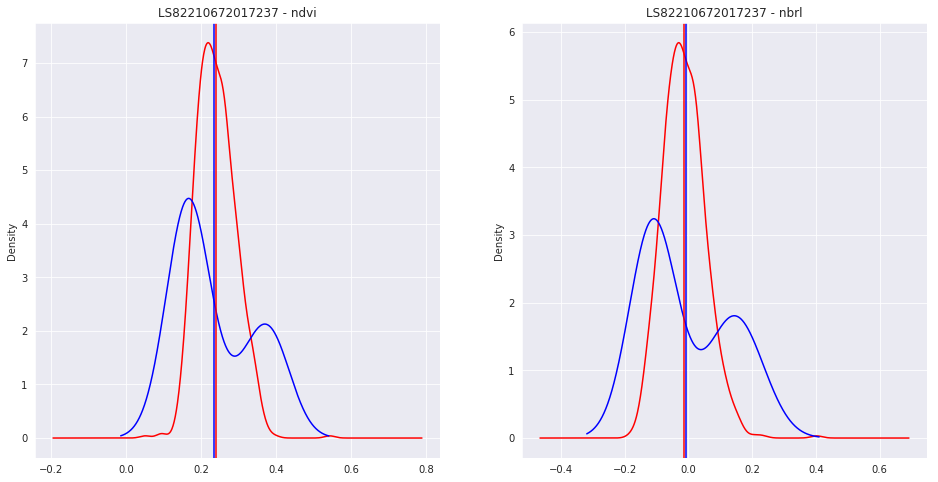

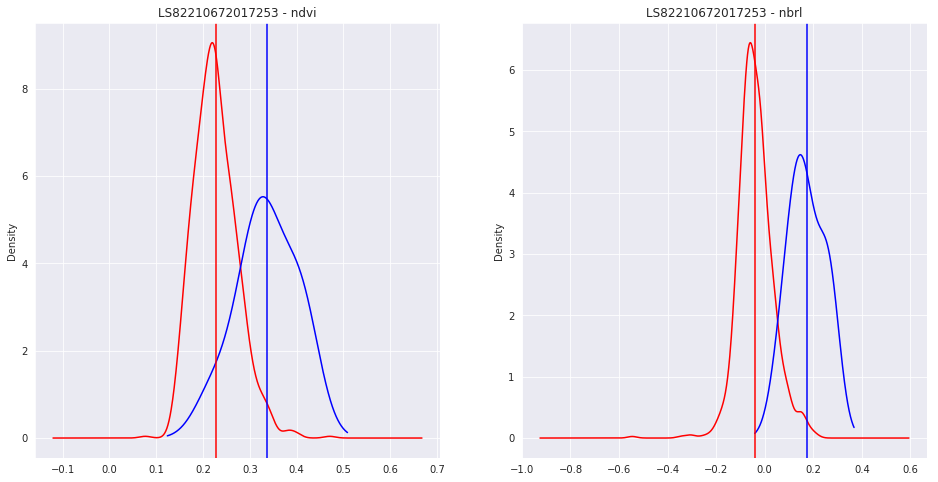

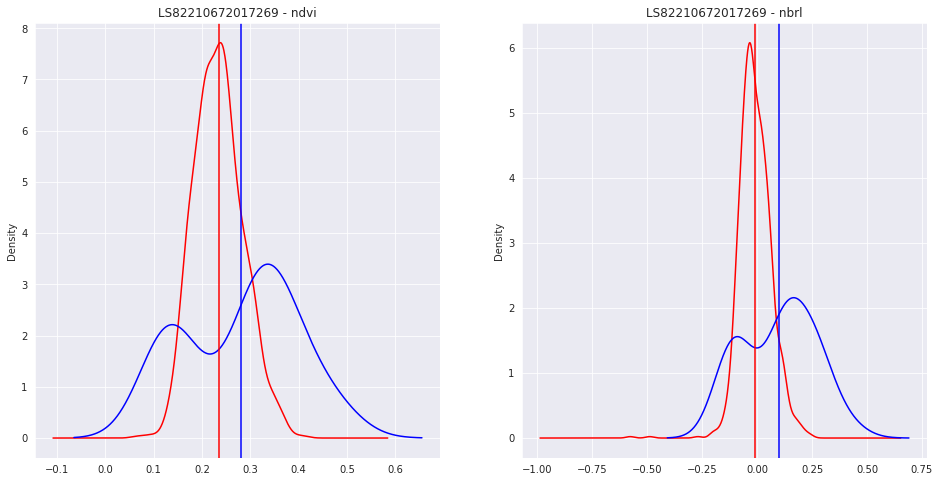

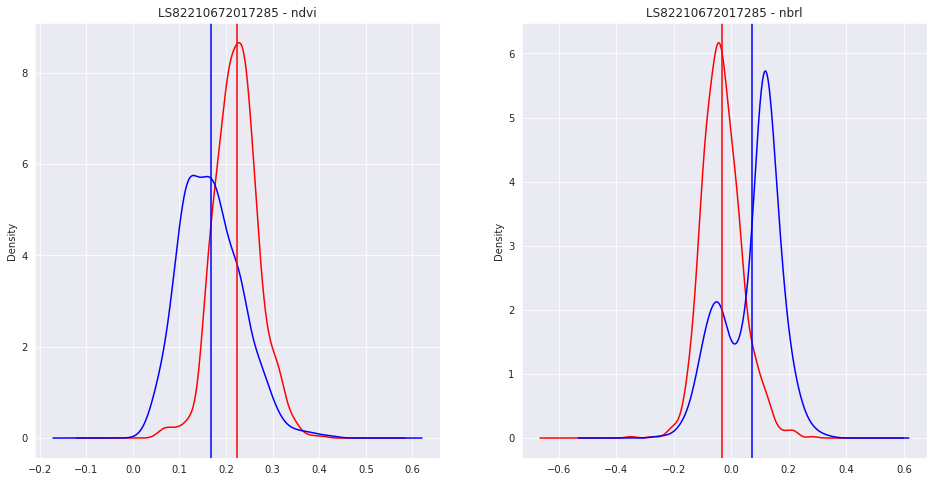

In [13]:
for i in id_cenas:
    fig, ax = plt.subplots(figsize=(16,8))
    d = df[df.id_cena==i].copy()
    d1 = d[d.verifica==1]
    d3 = d[d.verifica==3]
    
    col = 'ndvi'
    plt.subplot(1, 2, 1)
    plt.title('%s - %s' % (i, col))
    d1[col].plot.kde(c='r')
    d3[col].plot.kde(c='b')
    plt.axvline(d1[col].mean(), c='r')
    plt.axvline(d3[col].mean(), c='b')
    
    col = 'nbrl'
    plt.subplot(1, 2, 2)
    plt.title('%s - %s' % (i, col))
    d1[col].plot.kde(c='r')
    d3[col].plot.kde(c='b')
    plt.axvline(d1[col].mean(), c='r')
    plt.axvline(d3[col].mean(), c='b')

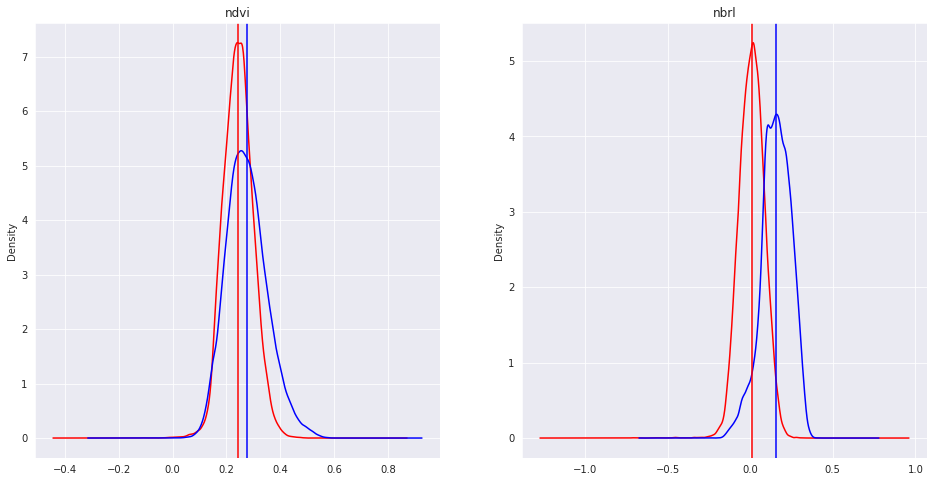

In [14]:
fig, ax = plt.subplots(figsize=(16,8))
d = df[df.id_cena.isin(id_cenas)]
d1 = d[d.verifica==1]
d3 = d[d.verifica==3]

col = 'ndvi'
plt.subplot(1, 2, 1)
plt.title(col)
d1[col].plot.kde(c='r')
d3[col].plot.kde(c='b')
plt.axvline(d1[col].mean(), c='r')
plt.axvline(d3[col].mean(), c='b')

col = 'nbrl'
plt.subplot(1, 2, 2)
plt.title(col)
d1[col].plot.kde(c='r')
d3[col].plot.kde(c='b')
plt.axvline(d1[col].mean(), c='r')
plt.axvline(d3[col].mean(), c='b')

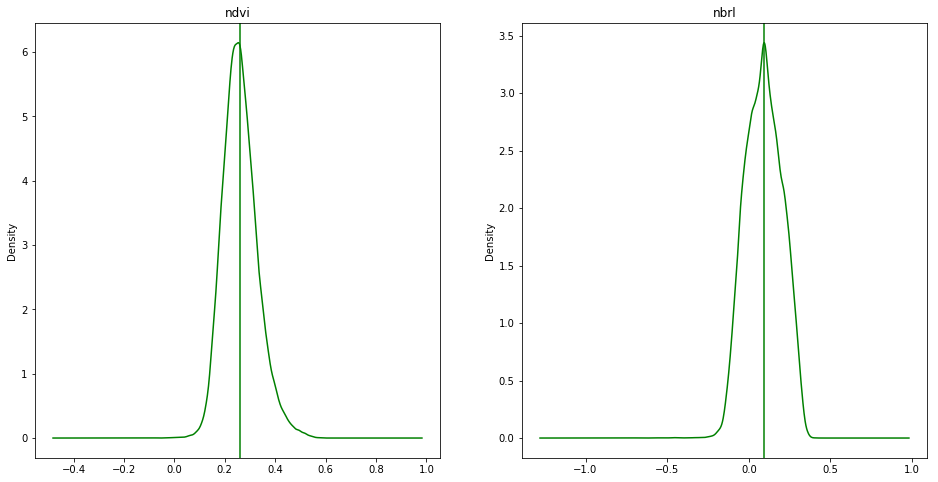

In [9]:
fig, ax = plt.subplots(figsize=(16,8))
d = df[df.id_cena.isin(id_cenas)]

col = 'ndvi'
plt.subplot(1, 2, 1)
plt.title(col)
d[col].plot.kde(c='g')
plt.axvline(d[col].mean(), c='g')

col = 'nbrl'
plt.subplot(1, 2, 2)
plt.title(col)
d[col].plot.kde(c='g')
plt.axvline(d[col].mean(), c='g')

In [10]:
modelo = df[df.id_cena.isin(id_cenas)]

In [11]:
print(len(modelo))

97062


In [12]:
print(modelo.id_cena.value_counts())

LS82210672015280    8535
LS82210672015168    7594
LS82210672013306    6231
LS82210672016251    4863
LS82210672016139    4835
LS82210672015056    4724
LS82210672013226    4112
LS82210672013162    3840
LS82210672016347    3203
LS82210672015072    3112
LS82210672016363    2603
LS82210672015184    2322
LS82210672015344    2145
LS82210672015136    2075
LS82210672013274    1838
LS82210672017141    1810
LS82210672015152    1763
LS82210672017285    1674
LS82210672016171    1642
LS82210672015200    1621
LS82210672013242    1611
LS82210672015216    1571
LS82210672015248    1520
LS82210672016123    1410
LS82210672015232    1327
LS82210672013210    1262
LS82210672013178    1178
LS82210672017173    1167
LS82210672016155    1163
LS82210672017157    1052
LS82210672017269    1047
LS82210672016187    1007
LS82210672017189    1006
LS82210672016235     981
LS82210672013258     977
LS82210672017205     930
LS82210672016203     916
LS82210672017221     898
LS82210672017253     848
LS82210672016219     815


In [13]:
id_cena = 'LS82210672017141'

## Remove cena selecionada do conhecimento

In [14]:
modelo = modelo[(modelo.id_cena!=id_cena)]

In [15]:
print(len(modelo))

95252


## Pega dados para classificar

In [16]:
# Dado que será classificado
teste = df[df.id_cena==id_cena].copy().reset_index(drop=True)

In [17]:
print(len(teste))

1810


In [18]:
print(teste.verifica.value_counts())

3    1091
1     719
Name: verifica, dtype: int64


## Escolhe colunas usandas nos classificadores

In [19]:
colunas = ['ndvi', 'nbrl', 'dif_ndvi', 'dif_dnbrl', 'medianb2', 'medianb3', 'medianb4', 'medianb5', 'medianb6', 'medianb7']

## Cria classificador com Random Forest

In [20]:
classificador = RandomForestClassifier(n_jobs=8, n_estimators=100, max_features=len(colunas), random_state=0, max_depth=3, min_samples_split=5)
classificador.fit(modelo[colunas], modelo.verifica)

RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=3, max_features=10, max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=5,
            min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=8,
            oob_score=False, random_state=0, verbose=0, warm_start=False)

## Coeficiente GINI
GINI é um indice para definir a desigualdade, criado por um italiano estatistico, variando o valor de 0 a 1, onde:


    - Próximo de 0: Igualdade
    - Próximo de 1: Desigualdade

Para diferenciar dado de AREA_QUEIMADA e de NAO_AREA_QUEIMADA, é mais importante que ocorra a DESIGUALDADE, para que possa ter diferença significativa entre si dentro do mesmo conjunto de dado.

In [21]:
rank = pd.DataFrame(sorted(list(zip(colunas,classificador.feature_importances_)), key=lambda x: x[1], reverse=True), columns=['coluna', 'gini'])
rank

,coluna,gini
0,medianb5,0.737022
1,nbrl,0.237386
2,medianb2,0.024019
3,dif_ndvi,0.001121
4,medianb3,0.000452
5,ndvi,0.000000
6,dif_dnbrl,0.000000
7,medianb4,0.000000
8,medianb6,0.000000
9,medianb7,0.000000


In [22]:
## Classifica usando usanfo Random Forest e usando todas colunas

In [23]:
teste['rf'] = classificador.predict(teste[colunas])

## Verifica resultado da classificação

In [24]:
def ver_resultado(dado, coluna_previsao, coluna_verdade):
    try:
        quantidade_acerto_verifica_1 = len(dado[(dado[coluna_previsao]==1) & (dado[coluna_verdade]==1)])
        total_veirifica1 = len(dado[dado[coluna_verdade]==1])
        porcentagem = int((quantidade_acerto_verifica_1*100)/total_veirifica1)
        resultado = pd.DataFrame(data=[
            [len(dado), total_veirifica1, quantidade_acerto_verifica_1, porcentagem]
        ],
            columns=['total_features', 'total_verifica_1', 'acertos_verifica_1', 'porcentagem_acerto']
        )
        return resultado
    except Exception as e:
        print(e)
        return e
        return [0, 0, 0]

In [25]:
ver_resultado(teste, 'rf', 'verifica')

,total_features,total_verifica_1,acertos_verifica_1,porcentagem_acerto
0,1810,719,677,94


## Testando com um modelo gerado com uma amostra de verifica 1 e 3 em mesma quantidade

In [26]:
modelo = df[df.id_cena.isin(id_cenas)] # Modelo com todas cenas da mesma orb_pto
modelo = modelo[(modelo.id_cena!=id_cena)] # Remove a cena atual do conhecimento

modelo_inteiro_1 = modelo[modelo.verifica==1]
modelo_inteiro_3_full = modelo[modelo.verifica==3]

if len(modelo_inteiro_3_full) > len(modelo_inteiro_1):
    id3 = np.random.choice(modelo_inteiro_3_full.id, len(modelo_inteiro_1), replace=False) 
    modelo_inteiro_3 = modelo_inteiro_3_full[modelo_inteiro_3_full.id.isin(id3)]
else:
    print('Existe mais verifica 1 do que 3')
    modelo_inteiro_3 = modelo_inteiro_3_full
    id1 = np.random.choice(modelo_inteiro_1.id, len(modelo_inteiro_3), replace=False) 
    modelo_inteiro_1 = modelo_inteiro_1[modelo_inteiro_1.id.isin(id1)]

modelo = pd.concat([modelo_inteiro_1, modelo_inteiro_3]).reset_index(drop=True)

In [27]:
modelo.verifica.value_counts()

3    42089
1    42089
Name: verifica, dtype: int64

## Cria classificador com Random Forest

In [28]:
classificador = RandomForestClassifier(n_jobs=-1, n_estimators=100, max_features=len(colunas), random_state=0, max_depth=3, min_samples_split=5)
classificador.fit(modelo[colunas], modelo.verifica)

RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=3, max_features=10, max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=5,
            min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=-1,
            oob_score=False, random_state=0, verbose=0, warm_start=False)

## Indice GINI

In [29]:
rank = pd.DataFrame(sorted(list(zip(colunas,classificador.feature_importances_)), key=lambda x: x[1], reverse=True), columns=['coluna', 'gini'])
rank

,coluna,gini
0,medianb2,0.716854
1,nbrl,0.122547
2,medianb5,0.084111
3,ndvi,0.071179
4,medianb6,0.005129
5,dif_ndvi,0.000167
6,medianb3,0.000013
7,dif_dnbrl,0.000000
8,medianb4,0.000000
9,medianb7,0.000000


## Classifica com Random Forest

In [30]:
teste['rf'] = classificador.predict(teste[colunas])

## Verifica resultado da classificação

In [31]:
ver_resultado(teste, 'rf', 'verifica')

,total_features,total_verifica_1,acertos_verifica_1,porcentagem_acerto
0,1810,719,687,95


## Testando com um modelo usando o trimestre histórico da orb_pto

In [32]:
orb_pto = '221_067'
modelo = df[df.orb_pto==orb_pto] # Modelo com todas cenas da mesma orb_pto
modelo = modelo[(modelo.id_cena!=id_cena)] # Remove a cena atual do conhecimento

In [33]:
classificador = RandomForestClassifier(n_jobs=-1, n_estimators=100, max_features=len(colunas), random_state=0, max_depth=3, min_samples_split=5)
classificador.fit(modelo[colunas], modelo.verifica)

RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=3, max_features=10, max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=5,
            min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=-1,
            oob_score=False, random_state=0, verbose=0, warm_start=False)

In [34]:
rank = pd.DataFrame(sorted(list(zip(colunas,classificador.feature_importances_)), key=lambda x: x[1], reverse=True), columns=['coluna', 'gini'])
rank

,coluna,gini
0,medianb2,0.596928
1,nbrl,0.194765
2,medianb5,0.176041
3,ndvi,0.028509
4,medianb6,0.002011
5,dif_ndvi,0.001746
6,dif_dnbrl,0.000000
7,medianb3,0.000000
8,medianb4,0.000000
9,medianb7,0.000000


In [35]:
teste['rf'] = classificador.predict(teste[colunas])

In [36]:
ver_resultado(teste, 'rf', 'verifica')

,total_features,total_verifica_1,acertos_verifica_1,porcentagem_acerto
0,1810,719,676,94


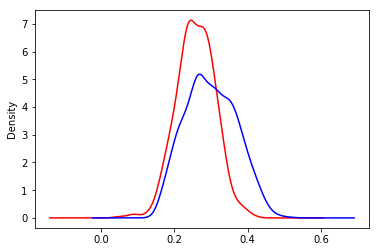

In [37]:
# teste.medianb2.plot.kde(c='b')
teste[teste.verifica==1].ndvi.plot.kde(c='r')
teste[teste.verifica==3].ndvi.plot.kde(c='b')
# teste.medianb7.plot.kde(c='g')

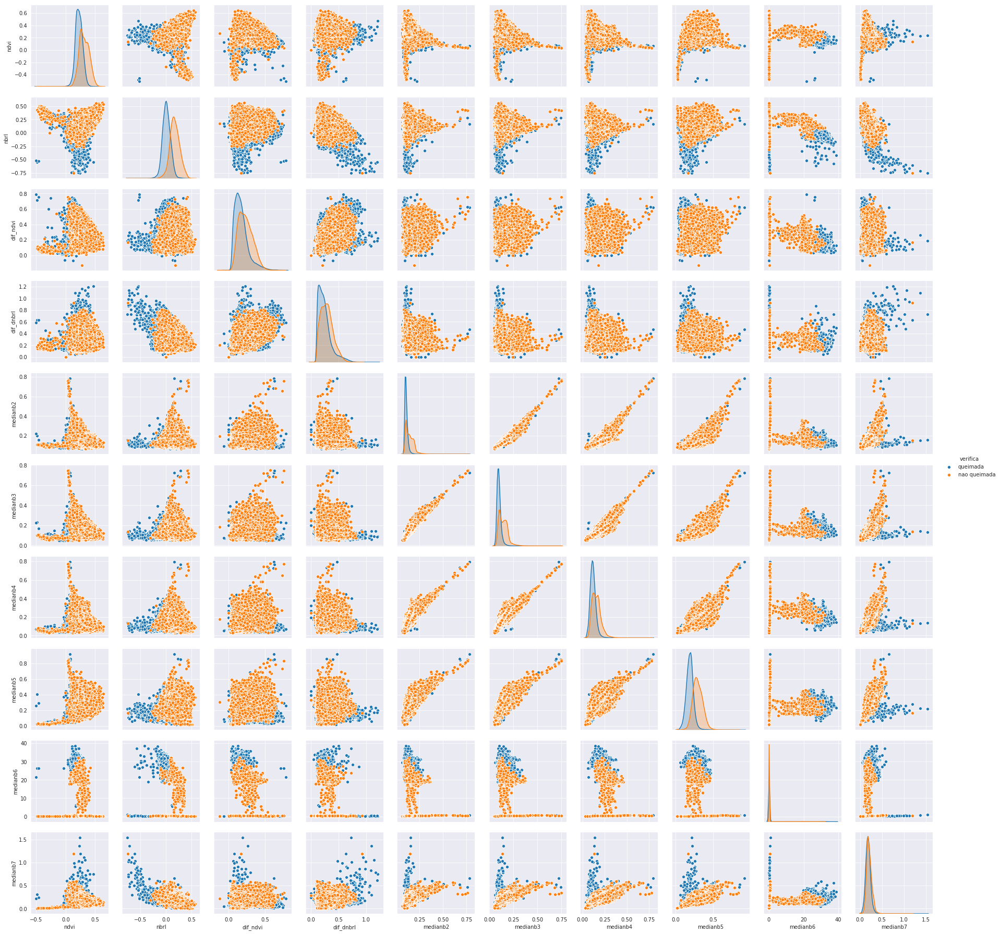

In [44]:
d = pd.concat([df1, df3_amostra])
d = d[colunas+['verifica']]
d['verifica'] = d['verifica'].apply(lambda x: 'queimada' if x==1 else 'nao queimada')
sns.pairplot(d, hue='verifica')

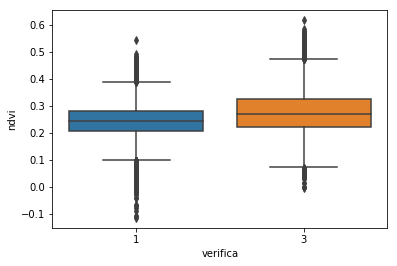

In [38]:
sns.boxplot(data=d,x='verifica', y='ndvi', )

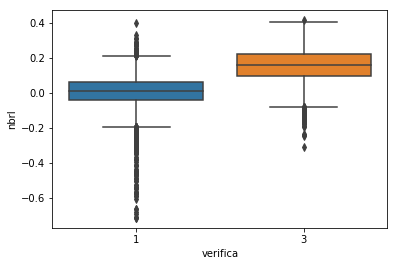

In [39]:
sns.boxplot(data=d,x='verifica', y='nbrl', )

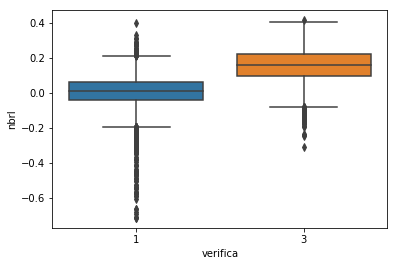

In [40]:
sns.boxplot(data=d,x='verifica', y='nbrl', )

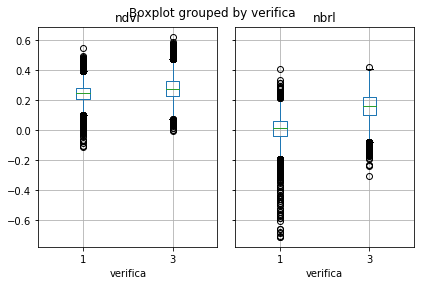

In [41]:
ax = d.boxplot(column=['ndvi', 'nbrl'], by='verifica',)
plt.tight_layout()

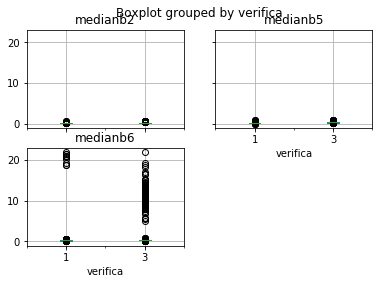

In [42]:
ax = d.boxplot(column=['medianb2', 'medianb5', 'medianb6'], by='verifica',)

In [43]:
correlacao = d[colunas].corr()

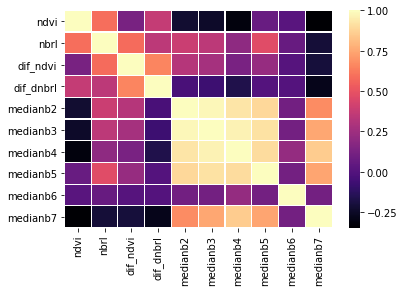

In [44]:
sns.heatmap(correlacao, cmap='magma', linecolor='white', linewidths=0.1)

/home/queimadas/.conda/envs/py3/lib/python3.6/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


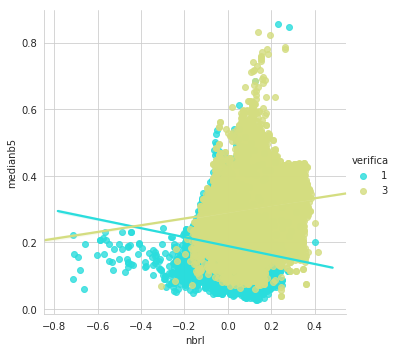

In [52]:
sns.lmplot(x='nbrl', y='medianb5', data=d, hue='verifica', palette='rainbow')